<a href="https://colab.research.google.com/github/chonzadaniel/dog-vision-classification/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#🐶🐕 End-to-end Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-class dog image (dog breed) classifier using TensorFlow 2.0 and TensorFlow Hub.

## 1. Problem

Identifying the dog breed given an image of a dog.

This classifier is expected to classify what breed a dog image belongs.

## 2. Data

Teh data used for this project is from Kaggle's dog breed identification competition.
https://www.kaggle.com/c/dog-breed-ifentification/data


## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image.
https://kaggle.com/c/dog-breed-identification/evaluation

## 4. Features

Some information about the data:
* Images (unstructured data) so it's probably best done using deep learning/transfer learning.
* There are 120 dog breeds (meaning there are 120 different classes).
*There are around 10,000+ images in the training set (images have labels).
* There are around 10000+ images in the test set (these images have no labels, because the classifier should be able to handle indicating the respective breed name/class).


In [1]:
# Unzip the uploaded data into Google Drive by uncommenting and running the below line of code
# !unzip "drive/My Drive/Dog Vision/dog-breed-identification.zip" -d "drive/My Drive/Dog Vision/"S

## Get our workspace ready

* Import TensorFlow 2.x✅
* Import TensorFlow Hub✅
* Make sure using a GPU available✅

In [2]:
# Import TensorFlow into Colab
# import tensorflow as tf
# print("TF version:", tf.__version__)

In [4]:
# Import TF 2.x in case is available
try:
    # %tensorflow_version only exists in Colab
    %tensorflow_version 2.x
except Exception:
    pass

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [5]:
# Import necessary tools
import tensorflow as tf
import tensorflow_hub as hub
print("The available TF version is:", tf.__version__)
print("The available Hub version:", hub.__version__)

The available TF version is: 2.17.0
The available Hub version: 0.16.1


In [6]:
# Check for GPU available
print("GPU", "available (YES, is there!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YES, is there!!!)


In [7]:
import timeit

device_name = tf.test.gpu_device_name()
if device_name != "/device:GPU:0":
    print(
        "\n\nThis error most likely means that this notebook is not "
        "configured to use a GPU.  Change this in Notebook Settings via the "
        "command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n"  )
    raise SystemError("GPU device not found")


def cpu():
    with tf.device("/cpu:0"):
        random_image_cpu = tf.random.normal([100, 100, 100, 3])
        net_cpu = tf.keras.layers.Conv2D(32, 7)(random_image_cpu)
        return tf.math.reduce_sum(net_cpu)


def gpu():
    with tf.device("/device:GPU:0"):
        random_image_gpu = tf.random.normal([100, 100, 100, 3])
        net_gpu = tf.keras.layers.Conv2D(32, 7)(random_image_gpu)
        return tf.math.reduce_sum(net_gpu)


# This runs each op once to warm up; see: https://stackoverflow.com/a/45067900
cpu()
gpu()


# Run the op serval times
print("Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images"
"(batch x height x width x channel). Sum of ten runs.")
print("CPU (s):")
cpu_time = timeit.timeit("cpu()", number=10, setup="from __main__ import cpu")
print(cpu_time)
print("GPU (s):)")
gpu_time = timeit.timeit("gpu()", number=10, setup="from __main__ import gpu")
print(gpu_time)
print("GPU speedup over CPU: {}x".format(int(cpu_time/gpu_time)))

Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images(batch x height x width x channel). Sum of ten runs.
CPU (s):
0.334961098000349
GPU (s):)
0.07192320300009669
GPU speedup over CPU: 4x


## Getting the data ready (turning data into Tensors)

With all machine learning models, data has to be in numerical format for the computer to be able to manipulate/calculate models. Hence, it's a necessary step turning images into Tensors (numerical representations).

The process start with loading the data and checking out key information (image labels). Note that data is already loaded to the Colab Drive in a specific project folder (Dog Vision).

In [8]:
# Check the image labels
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/Dog Vision/labels.csv")
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [9]:
print(labels_csv.describe())
print(labels_csv.info())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10222 entries, 0 to 10221
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      10222 non-null  object
 1   breed   10222 non-null  object
dtypes: object(2)
memory usage: 159.8+ KB
None


In [10]:
labels_csv.tail()

,id,breed
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher
10221,fff43b07992508bc822f33d8ffd902ae,chesapeake_bay_retriever


In [11]:
# How many images are there of each breed?
labels_csv["breed"].value_counts()

,count
breed,
scottish_deerhound,126
maltese_dog,117
afghan_hound,116
entlebucher,115
bernese_mountain_dog,114
...,...
golden_retriever,67
komondor,67
brabancon_griffon,67


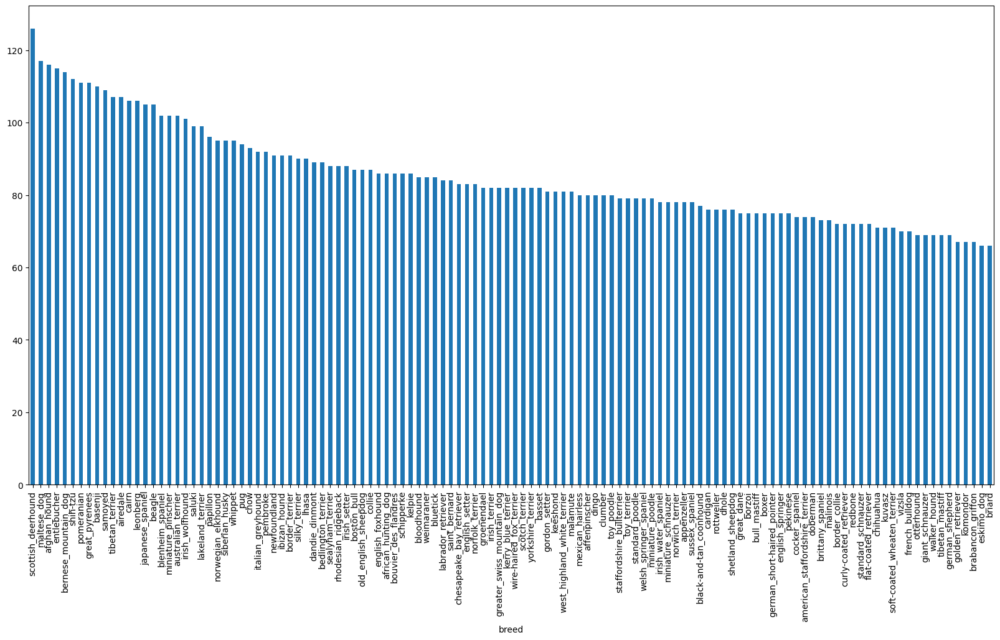

In [12]:
# Plot the number of counts for each breed
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

In [13]:
# Central Distribution of dog breeds
average_breed = labels_csv["breed"].value_counts().mean()
median_breed = labels_csv["breed"].value_counts().median()
print(f"The Average number of images per breed is: {average_breed}")
print(f"The Median number of images per breed is: {median_breed}")

The Average number of images per breed is: 85.18333333333334
The Median number of images per breed is: 82.0


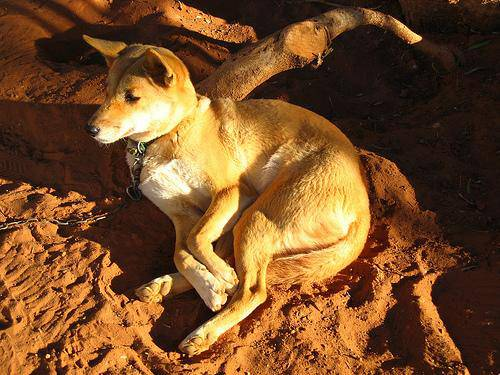

In [14]:
# Viewing the image
from IPython.display import Image
Image("drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

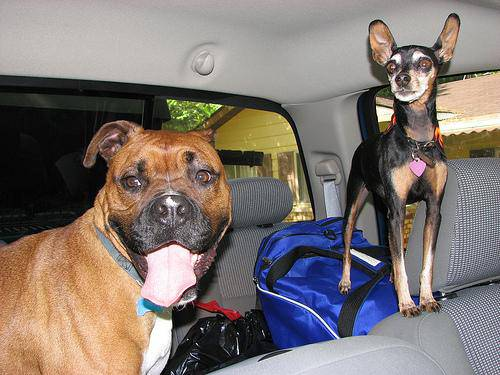

In [15]:
Image("drive/My Drive/Dog Vision/train/ffe5f6d8e2bff356e9482a80a6e29aac.jpg")

In [16]:
# Create image ID's list
filenames = [fname for fname in labels_csv["id"]]

# Check the first 10 ID's
filenames[:10]

['000bec180eb18c7604dcecc8fe0dba07',
 '001513dfcb2ffafc82cccf4d8bbaba97',
 '001cdf01b096e06d78e9e5112d419397',
 '00214f311d5d2247d5dfe4fe24b2303d',
 '0021f9ceb3235effd7fcde7f7538ed62',
 '002211c81b498ef88e1b40b9abf84e1d',
 '00290d3e1fdd27226ba27a8ce248ce85',
 '002a283a315af96eaea0e28e7163b21b',
 '003df8b8a8b05244b1d920bb6cf451f9',
 '0042188c895a2f14ef64a918ed9c7b64']

In [17]:
# Create pathnames form image ID's
filenames = ['drive/My Drive/Dog Vision/train/'+ fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10
filenames[:15]

['drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 'drive/My Drive/Dog Vision/train/004396df1acd0f1247b740ca2b14616e.jpg',
 'drive/My Drive/Dog Vision/train/0067dc3eab0b3c3ef0439477624d85d6.jpg',
 'drive/My Drive/Dog Vision/train/00693b8bc2470375cc744a6391d397ec.jpg',
 'drive/My Drive/Dog Vision/train/006cc3ddb9dc1bd82

In [18]:
len(filenames)

10222

In [19]:
# Check whether number of filenames matches number of actual image files
import os
if len(os.listdir("drive/My Drive/Dog Vision/train/")) == len(filenames):
    print("Number of image files matches the number of filenames!!! Proceed.")
else:
    print("Number of image files does not match the number of filenames!")

Number of image files matches the number of filenames!!! Proceed.


In [20]:
import os
os.listdir('drive/My Drive/Dog Vision/train/')[:15]

['dcfb91097cb730519db11709821e3afb.jpg',
 'df49b6b0d9d61736047884253bffbf46.jpg',
 'df08c075e337bb17c6dd66096f3dff4f.jpg',
 'e8cd220184f16fde613b32d157699edf.jpg',
 'e65087fe4a5ef4495d30e454f281b06f.jpg',
 'e466e0a3b43403c7bffd943fffc92ced.jpg',
 'e67eb5ae1ff58374b0e07398d5a0da5a.jpg',
 'e001b6f5092b2b90501111b23ab30d12.jpg',
 'e0417404576aa3117ab1a0c646743ed9.jpg',
 'e3f184140f68b3502dfb048607556438.jpg',
 'e4245709e4060e08146b5fe1af72385d.jpg',
 'e0cfa8c273838e25d74970683b285391.jpg',
 'e62630fa77dea4ee5a100e23edc6d061.jpg',
 'e3cc185776379b55e23a9973bce785b7.jpg',
 'e212cce60c302d24e8aaf0fb87ee0b2c.jpg']

In [21]:
labels_csv['id'][850]

'14babec7fedcfcfe575947797e2e01bd'

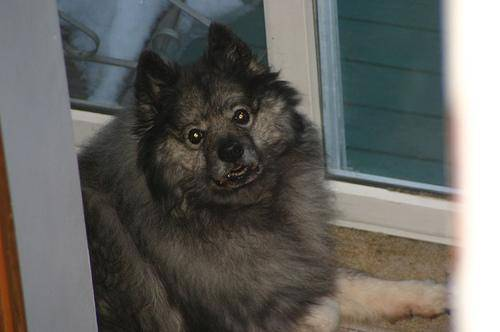

In [22]:
Image("drive/My Drive/Dog Vision/train/14babec7fedcfcfe575947797e2e01bd.jpg")

In [23]:
labels_csv['id'][9000]

'e20e32bf114141e20a1af854ca4d0ecc'

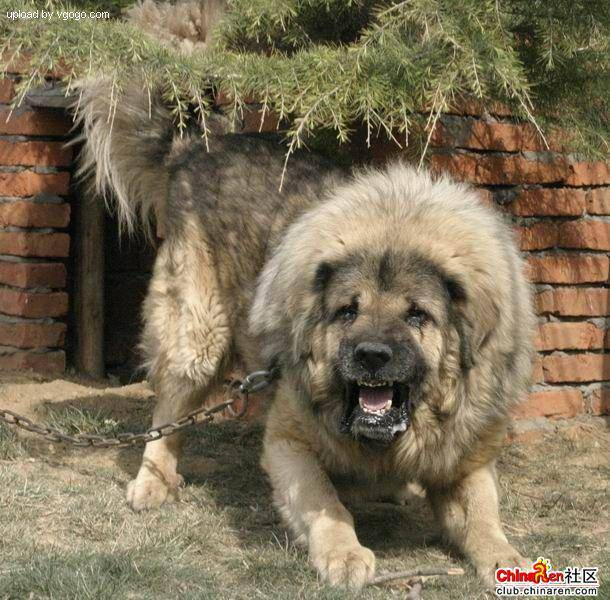

In [24]:
# One more check
Image("drive/My Drive/Dog Vision/train/e20e32bf114141e20a1af854ca4d0ecc.jpg")

Since the training image filepaths list is available, undergo labels preparation.


In [25]:
import numpy as np

labels = labels_csv["breed"].to_numpy()
# or
# labels = np.array(labels_csv["breed"])
labels[:20]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound', 'shetland_sheepdog', 'walker_hound',
       'maltese_dog', 'bluetick', 'norfolk_terrier',
       'african_hunting_dog', 'wire-haired_fox_terrier', 'redbone',
       'lakeland_terrier', 'boxer'], dtype=object)

In [26]:
# Check number of created labels
len(labels)

10222

In [27]:
# Check if number of labels matches number of filenames
if len(labels) == len(filenames):
    print("Number of labels matches number of filenames!!! Wonderful.")
else:
    print("Number of labels does not match number of filenames!!! Gosh....")

Number of labels matches number of filenames!!! Wonderful.


In [28]:
# Find the unique labels values
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [29]:
# Number of classes
len(unique_breeds)

120

In [31]:
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [32]:
# Turn a single label into an array of booleans
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [33]:
# Number of boolean labels
len(boolean_labels)

10222

In [34]:
# Example: Turning boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # boolean list to integers

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [35]:
print(labels[3])
print(boolean_labels[3].astype(int))

bluetick
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [36]:
filenames[:15]

['drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 'drive/My Drive/Dog Vision/train/004396df1acd0f1247b740ca2b14616e.jpg',
 'drive/My Drive/Dog Vision/train/0067dc3eab0b3c3ef0439477624d85d6.jpg',
 'drive/My Drive/Dog Vision/train/00693b8bc2470375cc744a6391d397ec.jpg',
 'drive/My Drive/Dog Vision/train/006cc3ddb9dc1bd82

## Since the Kaggle dataset doesn't come with validation set, this is the right time to perform the data split.

In [37]:
# Setup X & y variables

X = filenames
y = boolean_labels

In [38]:
len(X), len(y)

(10222, 10222)

Given the computational challenge with using big dataset during experimentation, it is important to get only a small dataset for this process. ~1500 is a fair size. But may increase as need be.

In [39]:
# Set number of images to use for experimenting
NUM_IMAGES = 1500 #@param {type: "slider", min:1500, max: 10000, step:500}

In [40]:
NUM_IMAGES

1500

In [41]:
# Import train_test_split from Scikit-Learn
from sklearn.model_selection import train_test_split

# Split them into training and validation using NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)
# Size of data splits
len(X_train), len(y_train), len(X_val), len(y_val)

(1200, 1200, 300, 300)

In [42]:
# Check out the training data (image file paths and labels)
X_train[:5], y_train[:2]

(['drive/My Drive/Dog Vision/train/0943d1d4677ab876b52468096baaa2ce.jpg',
  'drive/My Drive/Dog Vision/train/0d37ea8a209eb60e9c03eaedf3fd5384.jpg',
  'drive/My Drive/Dog Vision/train/24eff2c8a8903d51bf1c1888351f6494.jpg',
  'drive/My Drive/Dog Vision/train/1bbff1372370ec584225f44f6e33fb80.jpg',
  'drive/My Drive/Dog Vision/train/07d7cfbdbd3682cae50902b53c798028.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False,  True, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, Fa

## Preprocessing Images (turning images into Tensors)

To preprocess images into Tensors a helper function is used, which will do the following:

 1. Take an image filepath as input
 2. Use TensorFlow to read the file and save it to a variable, `image`
 3. Turn `image`(a .jpg) into Tensors
 4. Normalize our image (convert colour channel values from 0 - 225 to 0 - 1).
 5. Resize the `image` to be a size of (224 , 224)
 6. Return the modified `image`

A good place to read about this type of function is the TensorFlow documentation on loading images.

You might be wondering why (224, 224), which is (heigh, width). It's because this is the size of input our model takes, an image which is (224, 224, 3).

What? Where's the 3 from? That's the number of colour channels per pixel, red, green and blue.

 For more information on loading images in TensorFlow see: https://www.tensorflow.org/tutorials/load_data/images

In [43]:
filenames[42]

'drive/My Drive/Dog Vision/train/011e06760794850c40f23d6426c40774.jpg'

In [44]:
image_path = filenames
image_path[:15]

['drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 'drive/My Drive/Dog Vision/train/004396df1acd0f1247b740ca2b14616e.jpg',
 'drive/My Drive/Dog Vision/train/0067dc3eab0b3c3ef0439477624d85d6.jpg',
 'drive/My Drive/Dog Vision/train/00693b8bc2470375cc744a6391d397ec.jpg',
 'drive/My Drive/Dog Vision/train/006cc3ddb9dc1bd82

In [45]:
from matplotlib.pyplot import imread

# Check how successfully importing an image looks like
image_path_sub = filenames[42]
image = imread(image_path_sub)
print(image.shape)

(257, 350, 3)


In [46]:
# Image pixel range
image.min(), image.max()

(0, 255)

In [47]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

In [48]:
# Turn image into Tensor
tf.constant(image)[:3]

<tf.Tensor: shape=(3, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]],

       [[ 56, 104,  66],
        [ 58, 106,  68],
        [ 64, 112,  74],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 74, 130,  85]]], dtype=uint8)>

In [49]:
import tensorflow as tf
import os

# Define image size
IMG_SIZE = 224

# Specify device
device = "/CPU:0"  # This forces TensorFlow to use the CPU

def process_image(image_path):
    """
    Takes an image file path and turns image(s) into a Tensor(s) with 3 channels [Red, Green, Blue].
    """
    # Read in image file
    image = tf.io.read_file(image_path)
    # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
    image = tf.image.decode_jpeg(image, channels=3)
    # Convert the colour channel values from 0-225 values to 0-1 values
    image = tf.image.convert_image_dtype(image, tf.float32)
    # Resize the image to our desired size (224, 244)
    image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
    return image

In [50]:
tensor = tf.io.read_file(filenames[42])
tensor.numpy

<bound method _EagerTensorBase.numpy of <tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\n\x07\x07\x08\x07\x06\n\x08\x08\x08\x0b\n\n\x0b\x0e\x18\x10\x0e\r\r\x0e\x1d\x15\x16\x11\x18#\x1f%$"\x1f"!&+7/&)4)!"0A149;>>>%.DIC<H7=>;\xff\xdb\x00C\x01\n\x0b\x0b\x0e\r\x0e\x1c\x10\x10\x1c;("(;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;\xff\xc0\x00\x11\x08\x01\x01\x01^\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca\xd2\xd3\xd4\xd5\xd6\xd7\xd8\xd9\xda\xe1\xe2\xe3\xe4\xe5\xe6\xe7\xe8\xe9\xea\xf1\xf2\xf3\xf4\xf5\xf6\xf7\xf8\xf9\xfa\xff\xc4\x00\x1f\x01\x00\x03\x01\x01\x01\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x11\x00\x02\x01\x02\x04\x04\x03\x04\x07\x05\x04\x04\x00\x01\x02w\x00\x01\x02\x03\x11\x04\x05!1\x06\x12AQ\x07aq\x13"2\x81\x08\x14B\x91\xa1\xb1\xc1\t#3R\xf0\x15br\xd1\n\x16$4\xe1%\xf1\x17\x18\x19\x1a&\'()*56789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x82\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca\xd2\xd3\xd4\xd5\xd6\xd7\xd8\xd9\xda\xe2\xe3\xe4\xe5\xe6\xe7\xe8\xe9\xea\xf2\xf3\xf4\xf5\xf6\xf7\xf8\xf9\xfa\xff\xda\x00\x0c\x03\x01\x00\x02\x11\x03\x11\x00?\x00\xc3\x86\xefi$\xae\xe6=I\xa4\xb9\xbb\x92H\xc8\'\x02\xaa\xb3\x8d\xdb\xcf\xca)\x93L6c\xd6\xb9=\xd9t8\x12eO\xb5K\x0c\x8c\x01\xe3\xd4S\x96q,\x99\x91\xb9\x14\xe8b\xde\xd9=\rEuh\x11\xc1\x8c\xf5\xa7\x18\xf64\xba\x15\xee\x03\xca\x10\x0f\x94w\xabp\xa0,\x08\xebT\xe0\xb7\x1b\x94\x1e\xb5\xd0\xdbY\xa40y\x8cA\x18\xcdj\xdf*\xb9\x12\x97B\x94\x92\x90\xbbO\x15I\xe0\x13\xb1 \xfc\xdd\xaa\xdd\xdd\xc4E\x88L\x1a\xa8\x92\x14~\x9dj\x95\x9a\xd8\x13}\x08\x9fKwR7\x1a"\xb1\xf2S\x1dMh\xac\xa3\x03&\x95\x8a\xb7LUY\x07<\x8ap@\xc5\xbaT\xb7\x11\x1c\x03\x8f\xadXM\xb9\xa7\xb9\x05M.Uby\x9d\xcaj\xa1\x93h\xe0\xd5[\x8bg\xd8Yy\xc7Z\x9aK\x85G \x8a\x12\xe00#9\x06\xa6\xc8\xa4\xe4\xb50n\xc3\x9c\xfe\xa2\xa1\xb7\x85]\xb3\'\x02\xaf\xdeF\x0c\xa4\xa9\xc0=\xaa\xba.]S\x1dz\x9aI\xf4:T\x9f)f\xce\xcd%\x94\x04\x19\xad\xb4\xd3bE\x1b\xc6}\xaa\r:\x18\xed\x94\xb9"\xa4\x9bS]\xf8\x07\x81N\xca\xda\x9c\xd3\x94\xa4\xec\x85xm\x97\x82\x9bMT\x9a4\xd8\xea\x84\xf28\xc5L\xf3,\xf8#\xadG8\x08\xa3h\xdb\x91\xc9\xac\xe5t\x89\x8bkvc\x8b\t>g\x1c\xd59<\xc5}\xa5Mj$\x92\xac\xcc\xa9\xf3-*\xbc2\xc8VD\xc3U\xc5\xb3\xa1NKs2\tLr\xa9\xe9]\x14L\x970q\xd7\x15\xcf\xdf\xa0\x86~8SV,/\x8c=NT\xd3i=G4\xe5\x1ed]K\x84\x8aR\xae9\x07\xad]\xba\xd6#\x82\xd3b\xf2H\xc5a\xdc\xc8&\x98\xba\xf7\xa6K\x13\xb2\x82s\xc5f\x92#\x91I\xa6\xca\xf2?\x98\xe4\x9e\xa4\xe6\xa7\x85Di\x93T\xd8\x95|\x1e\xd57\x9d\xb9pk^Uk\x1d\r=\x8b\xad\x99\xa2%\x0f#\xb5V\xb5\xbc{[\x82\x18S`\xba0\xb6;zS\xa5h\xa6;\xc7\x07\xbd$\x92\xdcQ\xbcX]\xcd\xf6\x8b\x85p*\xdd\xbb\x11\x80j\xa6c\xc8\x03\xad_\x86<\xa8#\xd2\x87k\x1a\xb6\xc9\xd0\xfc\xe0\xf6\xab\xb0\xe0H\x0ej\xa0\xc0Q\xebK\xe6\x95\xc1\xee*]\x8c\xe7\x178\xd8\xdc\x12\x05L\x93\xc0\x15\x85v\xe1\xe4b:f\x89/d\x7f\x978\x15\x038\xeei\xb7s*T\xdc5e)\xd8!$Uq(w\x05\x87N\xb5\xa2-\x96`X\x9e*\x84\xf0mr\xab\xc8\x15I\xad\x8d\xda\xb24l.\xe3G\x00\x0c\x91R]fK\x80\xe80\xa6\xb1\x15\xde\x17\x04u\x15\xb9\xa7\xca.\xd4\x03\xc3\nR\x8e\x862V\xf7\x91z\xc2\xe4\xdbN\xacO\x03\xadu\xd0\xcc\'\xb7Y\x10\xf5\x15\xc8\xdeY\x94\xb7\x12/Q\xd6\xb6\xb4\t\xcb\xd9\x00O#\x8a\xc5\xab\x9c\xb2\xd7Rk\xa7e$\x9a\x85.\x01\x1c\x9a\x92\xed\xd8\x12\x0f\xdd\x1d\rf\xf9\xb8$\x1fZi"\x16\xa4\x170H\x10\xb0\xaa\x90\xabHp\xc7\x81Z\x92I\x

## Turning data into batches

Why turn data into batches?

* Handle the memory issues in case data is used in full (say 10,000 images). Batching makes it easy for computation as images are take in a small group.
* In order to use TensorFlow effectively, a Tensor tuple is created which looks like:
`(image, label)`

In [51]:
image_path[:5]

['drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

In [52]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
    """
    Takes an image file path name and the associated label,
    processes the image and returns a tuple of (image, label).
    """
    image = process_image(image_path)
    return image, label

In [53]:
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

## Define data batches

In [54]:
import tensorflow as tf
import os

# Define image size
IMG_SIZE = 224
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):

    """
    Creates batches of data out of image (x) and label (y) pairs.
    Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
    Also accepts test data as input (no labels).
    """
    # If the data is a test dataset, we probably don't have labels
    if test_data:
        print("Creating test data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
        data_batch = data.map(process_image).batch(BATCH_SIZE)
        return data_batch

    # If the data if a valid dataset, we don't need to shuffle it
    elif valid_data:
        print("Creating validation data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                                tf.constant(y))) # labels
        data_batch = data.map(get_image_label).batch(BATCH_SIZE)
        return data_batch

    else:
        # If the data is a training dataset, we shuffle it
        print("Creating training data batches...")
        # Turn filepaths and labels into Tensors
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                                tf.constant(y))) # labels

        # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
        data = data.shuffle(buffer_size=len(x))

        # Create (image, label) tuples (this also turns the image path into a preprocessed image)
        data = data.map(get_image_label)

        # Turn the data into batches
        data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [55]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [56]:
# Create training and validation data batches
train_data, val_data

(<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>,
 <_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>)

In [57]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

For easy understanding of the data batches, visualizing is handy.

In [58]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):

    """
    Displays 25 images from a data batch.
    """
    # Setup the figure
    plt.figure(figsize=(10, 10))
    # Loop through 25 (for displaying 25 images)
    for i in range(25):
        # Create subplots (5 rows, 5 columns)
        ax = plt.subplot(5, 5, i+1)
        # Display an image
        plt.imshow(images[i])
        # Add the image label as the title
        plt.title(unique_breeds[labels[i].argmax()])
        # Turn gird lines off
        plt.axis("off")

To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the `as_numpy_iterator()` method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to `next()` will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.

Note: Running the cell below and loading images may take a little while.

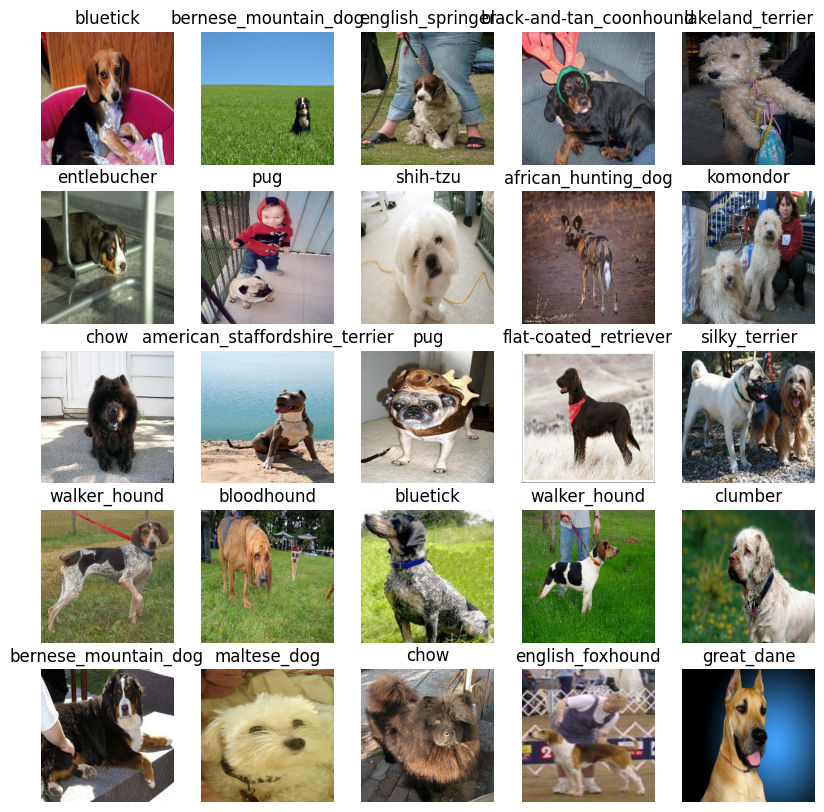

In [59]:
# Specify device
device = "/CPU:0"  # This forces TensorFlow to use the CPU
# Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

#
## Building a Machine Learning Model

Before building a moel, there are a few key things to point out:

 * Must ensure the input shape (the image shape, be in the form of Tensors) to the model...✅
 * The output shape (image labels in the form of Tensors) for the model to output.✅
 * Should be clear the model URL since this project is using transfer learning approach.✅ - https://www.tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4

In [60]:
# Define parameters
IMG_SIZE = 224
BATCH_SIZE = 32

# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # Batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # These are number of dog breed classes (120)

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

Now the model input shape, output shape, and the model itself are ready to go, putting them together into a Keras deep learning model!

Knowing this, the below steps are key to creating a function:

 * Takes the input shape, output shape, and the model.
 * Defines the layers in a Keras model in sequential fashion (i.e. do this first, then this, and then that).
 * Compile the model (it should be evaluated and improved).
 * Builds the model (tell the model input shape it will be accepting).
 * Return the model.

All the steps above could be clearly understood visiting here: https://www.tensorflow.org/guide/keras/overview

In [61]:
import tensorflow as tf

version_fn = getattr(tf.keras, "version", None)
print("TF Version: " + tf.__version__)
# print("TF Keras Version: " + version_fn())

TF Version: 2.17.0


In [62]:
!pip install tf_keras -q  # notice -q for quiet installation (maybe it is not needed as it could be installed properly)

In [63]:
import tensorflow as tf
import tf_keras
from tf_keras import callbacks
import tensorflow_hub as hub
import pandas as pd
import numpy as np
from tf_keras.optimizers import Adam, SGD
from tf_keras.callbacks import EarlyStopping, ModelCheckpoint
from tf_keras.models import Model, Sequential


# Setup random seed
np.random.seed(42)

# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):

    """
    This is a transfer learning model building. Takes an input shape, output shape and model
    URL (mobileNetV2) and creates a Keras model with it.
    """
    print("Building model with:", MODEL_URL)


    # Setup the model layers
    model = tf_keras.Sequential([
        hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
        tf_keras.layers.Dense(units=OUTPUT_SHAPE,
                              activation="softmax") # Layer 2 (output layer)
    ])

    # Compite the model
    model.compile(
        loss=tf_keras.losses.CategoricalCrossentropy(),
        optimizer=tf_keras.optimizers.Adam(),
        metrics=["accuracy"]  # convinient (default) for a classification problem
    )

    # Build the model
    model.build(INPUT_SHAPE)

    return model

Since `hub.KerasLayer` recognises Keras version 2 instead of 3, when I used `tf.keras` instead of `tf_keras` encountered a "ValueError: Only instances of keras.Layer can be added to a Sequential model. Received: <tensorflow_hub.keras_layer.KerasLayer object at 0x78b89f3d15d0> (of type <class 'tensorflow_hub.keras_layer.KerasLayer'>)". Hence, important to understand for future use.

In [64]:
# Create the model
model_tr = create_model()

# Build model
model_tr.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


## Creating callbacks

Callbacks are helper functions where a model can use during training to do such tings as save its progress, check its progress or stop training early if a model stops improving.

Two callbacks are created:

 * TensorBoard: which helps track the models progress.
 * Early stopping: which prevents the models form training for too long.

### TensorBoard Callbacks

 1. Load the TensorBoard notebook extension✅
 2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()`function✅
 3. Visualize the models training logs with the `%tensorboard` magic function (done after model training)✅

In [65]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [66]:
import tensorflow as tf
import tf_keras
from tf_keras import callbacks
import tensorflow_hub as hub
import pandas as pd
from tf_keras import callbacks
from tf_keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
import datetime, os

# Setup random seed
np.random.seed(42)

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
    """
    Model training  creating a TensorBoard callback.
    """
    # Create a log directory for storing TensorBoard logs
    logdir = os.path.join("drive/MyDrive/Dog Vision/logs",
                          # Make it so the logs get tracked during model experimentation
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

    # Create tensorboard callbacks
    tensorboard_callback = tf_keras.callbacks.TensorBoard(logdir,
                                                          histogram_freq=1)

    # Return the logs
    return tensorboard_callback

### Early Stopping Callback

Early stopping helps stop the model overfitting by stopping traiing if a certain evaluation metric stops improving.


https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [67]:
import tf_keras

# Create early stopping callback
early_stopping = tf_keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=8)

## Training the model (on subset of data - model experiementation)

The first model is only going to train on about 1,500 out of over 10,000 images, to make sure everything is working.

In [68]:
NUM_EPOCHS = 100 #@param {type: "slider", min:10, max: 100}

In [69]:
# Check to make sure GPU is working
print("GPU", "available (YESSS!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESSS!!!)


### Create a model using `create_model()`

 * Create a model using `create_model()`
 * Setup a Tensorboard callback using `create_tensorboard_callback()`
 * Call the `fit()` function on the model passibng it the training data, validation data, number of epoches to train for (`NUM_EPOCHS`) and the callbacks of the choice
 * Return the model

In [70]:
# Setup random seed
np.random.seed(42)

# Build a function to train and return a trained model
def train_model():
    """
    Trains a given model and returns the trained version. That's it takes in a model to train
    and a set of callbacks to call during training.
    """

    # Create a model
    model_tr = create_model()


    # Create new TensorBoard session everytime the model is trained
    tensorboard = create_tensorboard_callback()

    # Fit the model to the data passing it the callbacks created
    model_tr.fit(x=train_data,
                 epochs=NUM_EPOCHS,
                 validation_data=val_data,
                 validation_freq=1,
                 callbacks=[tensorboard, early_stopping])

    # Return the fitted model
    return model_tr

In [71]:
# Fit the model to the data
model_tr = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
38/38 [==============================] - 92s 2s/step - loss: 4.0879 - accuracy: 0.1725 - val_loss: 2.3720 - val_accuracy: 0.4433
Epoch 2/100
38/38 [==============================] - 4s 107ms/step - loss: 1.1049 - accuracy: 0.7833 - val_loss: 1.3456 - val_accuracy: 0.6733
Epoch 3/100
38/38 [==============================] - 4s 108ms/step - loss: 0.3920 - accuracy: 0.9525 - val_loss: 1.1073 - val_accuracy: 0.7233
Epoch 4/100
38/38 [==============================] - 4s 110ms/step - loss: 0.1985 - accuracy: 0.9850 - val_loss: 1.0365 - val_accuracy: 0.7367
Epoch 5/100
38/38 [==============================] - 4s 108ms/step - loss: 0.1213 - accuracy: 0.9975 - val_loss: 0.9923 - val_accuracy: 0.7400
Epoch 6/100
38/38 [==============================] - 4s 107ms/step - loss: 0.0868 - accuracy: 0.9983 - val_loss: 0.9620 - val_accuracy: 0.7500
Epoch 7/100
38/38 [==============================] 

**Question:** It looks lke the model is overfitting because it's performing far better on the training set than the validation datase. What are some ways to prevent overfitting in deep learning neural networks?

**Note**: Overfitting to begin with is a good thing! It means the model is learning!!!

## Checking the Tensorboard logs

The TensorBoard magic funciton (`%tensorboard`) will access the logs director created earlr and visualize its contexts

In [72]:
%tensorboard --logdir drive/MyDrive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model

In [73]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [74]:
# Make predictions on the validation data (not used to train on)
predictions = model_tr.predict(val_data, verbose=1)
predictions

10/10 [==============================] - 1s 39ms/step


array([[8.7541202e-06, 4.0081196e-04, 5.5211727e-05, ..., 1.0915373e-05,
        1.1964367e-05, 8.1866318e-07],
       [1.2456581e-03, 9.4795323e-06, 5.5114729e-06, ..., 1.1498003e-06,
        8.3822801e-05, 5.1779274e-02],
       [4.3165885e-05, 3.4353313e-06, 3.1408821e-05, ..., 3.6320750e-06,
        1.6429407e-05, 7.9407851e-04],
       ...,
       [9.1623719e-04, 3.9388407e-03, 9.8068173e-05, ..., 2.5487738e-05,
        1.1188453e-04, 4.8732720e-05],
       [5.4149068e-06, 1.6849144e-07, 1.3574817e-07, ..., 1.0860091e-07,
        1.0293862e-07, 9.9546860e-06],
       [6.3171894e-05, 2.7334861e-06, 6.1634851e-06, ..., 2.2412169e-06,
        3.2596238e-06, 3.0335017e-05]], dtype=float32)

In [75]:
predictions[1]

array([1.24565815e-03, 9.47953231e-06, 5.51147286e-06, 1.26173891e-05,
       1.90930601e-04, 1.17088402e-05, 1.74306389e-02, 7.83159267e-05,
       5.60146655e-05, 1.78839946e-05, 2.59823537e-05, 2.24103773e-04,
       2.87480361e-04, 3.04034857e-05, 3.47415655e-04, 6.06167450e-05,
       6.18102349e-05, 1.13275943e-04, 1.17606373e-06, 8.94061232e-04,
       2.58531800e-05, 7.40041287e-05, 3.36712801e-05, 1.64517929e-04,
       1.51722625e-05, 2.83229980e-04, 1.41320255e-04, 2.00088325e-05,
       9.02813554e-06, 3.82320519e-04, 6.30665018e-05, 5.47474738e-05,
       3.64702682e-05, 2.16112880e-06, 2.31600484e-06, 1.36543205e-03,
       2.11610059e-05, 2.62000231e-05, 5.24087363e-06, 2.90718776e-06,
       2.36997439e-05, 3.36638459e-06, 9.58725832e-06, 1.40802267e-05,
       4.28144358e-06, 8.84696128e-05, 1.21330986e-05, 2.73084315e-05,
       1.03395214e-05, 1.37048528e-05, 1.82034346e-05, 1.88003480e-06,
       1.37540258e-06, 4.36636437e-05, 1.69211285e-06, 1.66354785e-05,
      

In [76]:
np.array(y[1])

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [77]:
predictions.shape

(300, 120)

In [78]:
predictions[0]

array([8.75412024e-06, 4.00811958e-04, 5.52117272e-05, 3.62533610e-04,
       1.03981586e-06, 1.23898599e-05, 1.70323449e-06, 1.92386119e-06,
       6.79290997e-06, 7.52008816e-07, 5.36666950e-04, 1.02091217e-05,
       1.49727981e-07, 6.54968972e-06, 4.87238067e-05, 2.46441741e-05,
       1.27997591e-05, 4.21239719e-07, 1.53809873e-04, 9.24129111e-08,
       1.61661737e-05, 1.12538068e-08, 5.90183902e-08, 4.24121863e-05,
       5.25050418e-05, 4.90715183e-06, 1.06718312e-06, 3.32973258e-07,
       3.60054328e-05, 4.43542412e-08, 1.68670067e-05, 2.48142096e-05,
       3.27605201e-04, 9.79115721e-05, 1.59840367e-03, 8.78632420e-07,
       4.94501182e-06, 2.55421605e-06, 2.61279220e-05, 2.02727315e-05,
       1.44190631e-06, 9.95015034e-06, 2.09575342e-06, 5.88770927e-05,
       3.99693308e-05, 3.82523422e-06, 9.10633901e-07, 1.66553418e-05,
       2.72387726e-04, 3.98524062e-05, 2.93431494e-05, 1.20500146e-04,
       1.15687253e-05, 3.92433640e-06, 2.67194206e-04, 2.01275839e-06,
      

In [79]:
np.sum(predictions[0])

1.0

In [80]:
# First prediction
index = 0
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])}")
print(f"Sum: {np.sum(predictions[index])}")
print(f"Max index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")

[8.75412024e-06 4.00811958e-04 5.52117272e-05 3.62533610e-04
 1.03981586e-06 1.23898599e-05 1.70323449e-06 1.92386119e-06
 6.79290997e-06 7.52008816e-07 5.36666950e-04 1.02091217e-05
 1.49727981e-07 6.54968972e-06 4.87238067e-05 2.46441741e-05
 1.27997591e-05 4.21239719e-07 1.53809873e-04 9.24129111e-08
 1.61661737e-05 1.12538068e-08 5.90183902e-08 4.24121863e-05
 5.25050418e-05 4.90715183e-06 1.06718312e-06 3.32973258e-07
 3.60054328e-05 4.43542412e-08 1.68670067e-05 2.48142096e-05
 3.27605201e-04 9.79115721e-05 1.59840367e-03 8.78632420e-07
 4.94501182e-06 2.55421605e-06 2.61279220e-05 2.02727315e-05
 1.44190631e-06 9.95015034e-06 2.09575342e-06 5.88770927e-05
 3.99693308e-05 3.82523422e-06 9.10633901e-07 1.66553418e-05
 2.72387726e-04 3.98524062e-05 2.93431494e-05 1.20500146e-04
 1.15687253e-05 3.92433640e-06 2.67194206e-04 2.01275839e-06
 2.38612956e-05 3.91861795e-06 6.95474620e-04 4.50188600e-05
 2.24141240e-06 1.61031551e-06 4.17643278e-05 2.21638657e-05
 2.50904239e-04 1.876779

**Note:** Prediction probabilities are also know as confidence levels..

In [81]:
# Turn prdiction probabilities
def get_pred_label(predictions_probablities):
    """
    Turns an array of prediction probabilities into a label.
    """
    return unique_breeds[np.argmax(predictions_probablities)]

# Get a predicted label based on array of prediction probabilities
pred_label = get_pred_label(predictions[23])
pred_label

'affenpinscher'

In [83]:
# Create a function to unbatch a batch dataset
def unbatchify(data):
    """
    Takes a batched dataset of (image, label) Tensors and returns separate arrays
    of images and labels.
    """

    images = []
    labels = []

    # Look through unbached data
    for image, label in val_data.unbatch().as_numpy_iterator():
        images.append(image)
        labels.append(label)
    return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.8268084 , 0.87778884, 0.7004078 ],
         [0.6187892 , 0.6546785 , 0.4486211 ],
         [0.5687251 , 0.5795444 , 0.37021554],
         ...,
         [0.50412035, 0.430871  , 0.31312126],
         [0.4577594 , 0.39109275, 0.27344567],
         [0.4720942 , 0.40542755, 0.28940907]],
 
        [[0.80234873, 0.8557451 , 0.668105  ],
         [0.6145899 , 0.65047926, 0.4365787 ],
         [0.5239124 , 0.5347317 , 0.32053345],
         ...,
         [0.6066145 , 0.5334421 , 0.4162012 ],
         [0.494317  , 0.41588563, 0.31009743],
         [0.6022375 , 0.52380615, 0.42283303]],
 
        [[0.8199738 , 0.8744019 , 0.6803554 ],
         [0.7015197 , 0.73740906, 0.51854175],
         [0.75504184, 0.76833254, 0.54100406],
         ...,
         [0.91317713, 0.8468256 , 0.74259466],
         [0.65882725, 0.5773006 , 0.49019808],
         [0.6000929 , 0.51628685, 0.4302312 ]],
 
        ...,
 
        [[0.930187  , 0.7882501 , 0.59816927],
         [0.843736  , 0.6940772 , 0.55340

#
## Now is possible to get:
 * Prediction labels
 * Validation labels (truth labels)
 * Validation images

 Create a function which:

  * takes an array of prediction probabilities, an array of trugh lables and an array of images and inegers.
  * Convert the predction probabilities to a predicted label.
  * Plot the predicted label, its predicted proabilities, the truth label and the target image on a single plot.

In [84]:
def plot_pred(prediction_probabilities, labels, images, unique_breeds, n=1):
    """
    View the prediction, ground truth label, and image for a sample.
    Args:
    - prediction_probabilities: array-like, predicted probabilities for each class.
    - labels: array-like, true labels (one-hot encoded).
    - images: array-like, the images.
    - unique_breeds: list, unique breed names corresponding to classes.
    - n: int, index of the sample to visualize.
    """
    # Convert the dataset (if needed) to a list of batches
    if isinstance(labels, tf.data.Dataset):
        labels = list(labels.as_numpy_iterator())
    if isinstance(images, tf.data.Dataset):
        images = list(images.as_numpy_iterator())

    # Get the nth prediction, true label, and image
    pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

    # Convert the true label from one-hot encoding to the actual breed name
    true_label_name = unique_breeds[np.argmax(true_label)]

    # Get the predicted label by finding the index with the highest probability
    pred_label_idx = np.argmax(pred_prob)
    pred_label_name = unique_breeds[pred_label_idx]

    # Get the prediction probability (max probability)
    pred_prob_percent = np.max(pred_prob) * 100

    # Determine if the prediction is correct
    if pred_label_name == true_label_name:
        title_color = "green"
    else:
        title_color = "red"

    # Plot image & remove ticks
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])

    # Display the predicted label, probability of prediction, and true label
    plt.title(f"{pred_label_name} {pred_prob_percent:.2f}% {true_label_name}",
              color=title_color)

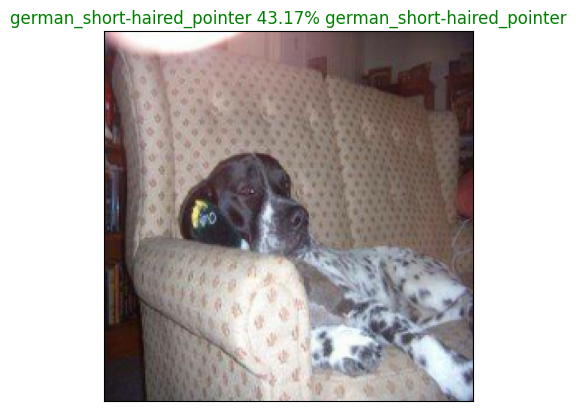

In [85]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          unique_breeds=unique_breeds, n=88)

#
## Visualizing the top 10 predictions

This function will:
 * Take an input of prediction proabilities array and a ground truth array and an integer
 * Find the prediciton using `get_pred_label()`
 * Find the top 10:
   * Prediction probabilities indexes
   * Prediction probabilities values
   * Prediction labels
 * Plot the top 10 prediciton probability values and labels, colringthe true label green.

In [86]:
import matplotlib.pyplot as plt

def plot_top_predictions(prediction_probabilities, labels, images, unique_breeds, top_n=25):
    """
    Visualize the top N predictions for the given dataset.
    Args:
    - prediction_probabilities: array-like, predicted probabilities for each class.
    - labels: array-like, true labels (one-hot encoded).
    - images: array-like, images corresponding to the predictions.
    - unique_breeds: list, unique breed names corresponding to classes.
    - top_n: int, number of top predictions to visualize.
    """
    # Create subplots (5x5 grid for 25 images)
    fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(20, 20))

    # Flatten axes for easier indexing
    axes = axes.flatten()

    for i in range(top_n):
        ax = axes[i]

        # Get prediction probabilities, true label, and image for the i-th image
        pred_prob = prediction_probabilities[i]
        true_label = labels[i]
        image = images[i]

        # Get the predicted label and true label names
        pred_label_idx = np.argmax(pred_prob)
        pred_label_name = unique_breeds[pred_label_idx]
        true_label_name = unique_breeds[np.argmax(true_label)]

        # Get the top prediction probability value
        pred_prob_percent = np.max(pred_prob) * 100

        # Determine the color of the title based on prediction correctness
        if pred_label_name == true_label_name:
            title_color = "green"
        else:
            title_color = "red"

        # Plot the image
        ax.imshow(image)
        ax.set_xticks([])
        ax.set_yticks([])

        # Set the title with prediction information
        ax.set_title(f"Predicted: {pred_label_name} {pred_prob_percent:.2f}% \nActual: {true_label_name}",
                     color=title_color, fontsize=10)

    # Adjust layout for better spacing
    plt.tight_layout()
    plt.show()

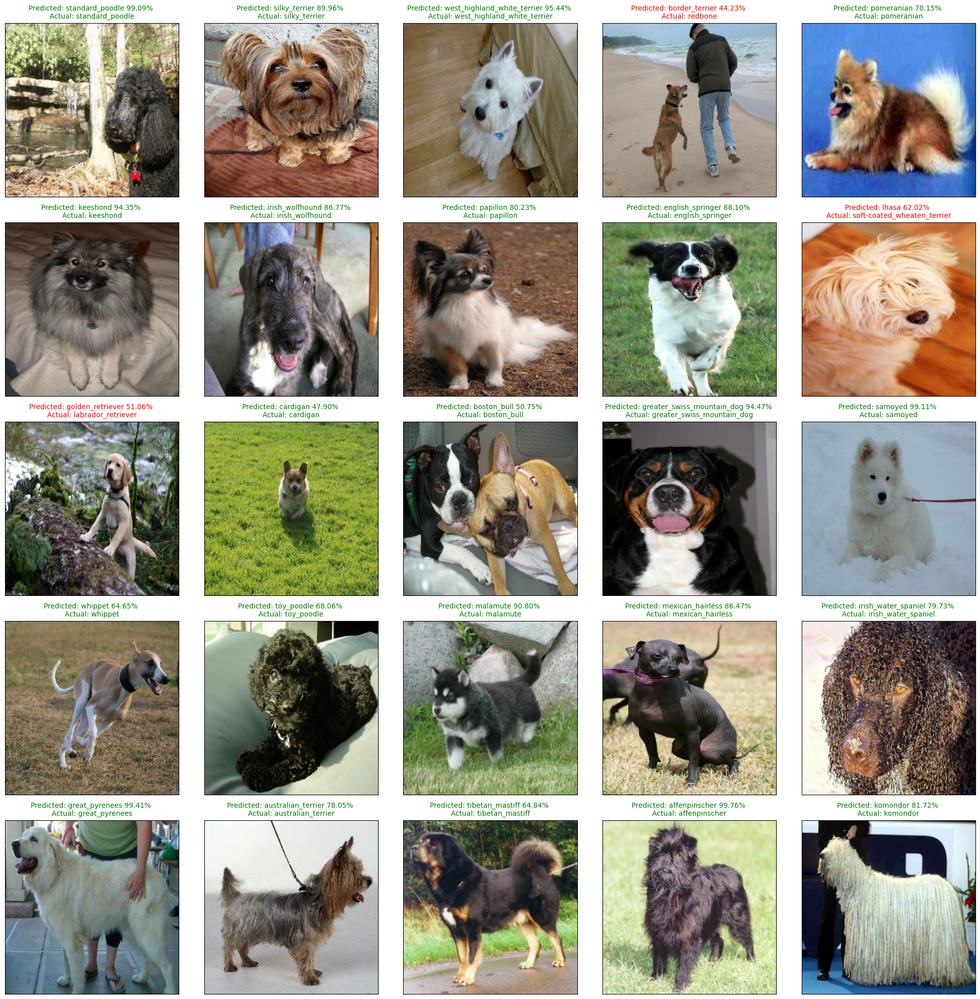

In [87]:
plot_top_predictions(prediction_probabilities=predictions,
                     labels=val_labels,
                     images=val_images,
                     unique_breeds=unique_breeds)

## Plotting the top 10 predictions

In [88]:
# Create a model to plot the top 10 predictions
def plot_pred_conf(prediction_probabilities, labels, n=1):
    """
    Plots the top highest prediction confidences along with the true label for example n.
    """
    pred_prob = prediction_probabilities[n]

    # Convert true_label from one-hot encoding to label index
    true_label_index = np.argmax(labels[n])  # Converts one-hot encoding to an index
    true_label = unique_breeds[true_label_index]  # Get the true label name

    # Find the top 10 prediction confidence indexes
    top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
    # Find the top 10 prediction confidence values
    top_10_pred_values = pred_prob[top_10_pred_indexes]
    # Find the top 10 prediction labels
    top_10_pred_labels = unique_breeds[top_10_pred_indexes]

    # Setup plot
    top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                       top_10_pred_values,
                       color='grey')
    # x-axis labels
    plt.xticks(np.arange(len(top_10_pred_labels)),
               labels=top_10_pred_labels,
               rotation='vertical')

    # Change color of the true label if it is in the top 10 predictions
    if true_label in top_10_pred_labels:
        top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('green')
    else:
        pass

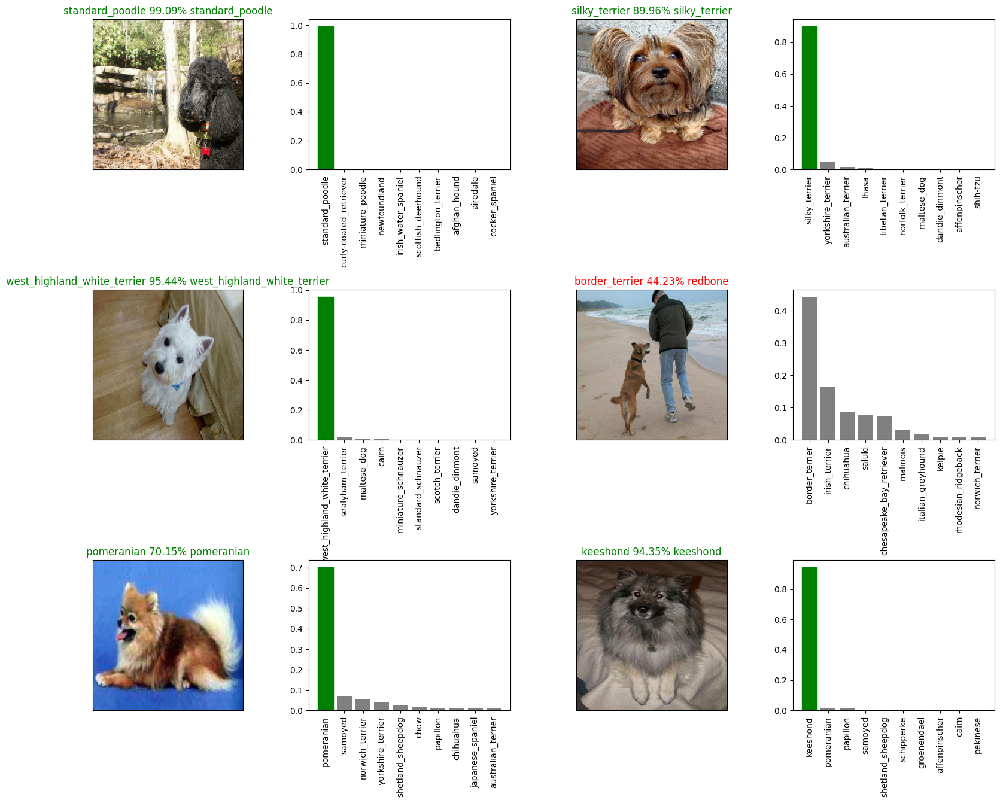

In [89]:
# Adjusting the for loop to work with the updated function
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows * num_cols
plt.figure(figsize=(10 * num_cols, 5 * num_rows))

for i in range(num_images):
    plt.subplot(num_rows, 2 * num_cols, 2 * i + 1)
    plot_pred(prediction_probabilities=predictions,
              labels=val_labels,
              images=val_images,
              unique_breeds=unique_breeds, n=i + i_multiplier)

    plt.subplot(num_rows, 2 * num_cols, 2 * i + 2)
    plot_pred_conf(prediction_probabilities=predictions,
                   labels=val_labels, n=i + i_multiplier)

# Adjusting the space between rows for better visibility of labels
plt.subplots_adjust(hspace=0.8)

plt.show();

## Saving and reloading a trained model!

In [90]:
model_tr

In [91]:
import os
import datetime


# Create a function to save a model
def save_model(model, suffix=None):
    """
    Saves a given model in a models directory and appends a suffix (string)
    for clarity.
    """
    # Create a model directory pathname with current time
    modeldir = os.path.join("drive/MyDrive/Dog Vision/models",
                            datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
    model_path = modeldir + "-" + suffix + ".h5" # save format of model
    print(f"Saving model to: {model_path}...")
    model.save(model_path)

    return model_path

In [92]:
import tf_keras
import os
import datetime
import keras
import tensorflow as tf
from tf_keras import callbacks
import tensorflow_hub as hub
import pandas as pd
from tf_keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard

# Create a function to load a trained model
def load_model(model_path):
    """
    Loads a saved model from a specified path.
    """
    print(f"Loading saved model from: {model_path}")
    model = tf_keras.models.load_model(model_path,
                                        custom_objects={"KerasLayer":hub.KerasLayer})
    return model

### Apply the save and reload model functions

In [93]:
# Save the model trained on 1500 images
save_model(model_tr, suffix="1500-images-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog Vision/models/20240907-19001725735649-1500-images-mobilenetv2-Adam.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Dog Vision/models/20240907-19001725735649-1500-images-mobilenetv2-Adam.h5'

In [94]:
# Reload the trained model and Evaluate the model
loaded_1500_model_tl = load_model("drive/MyDrive/Dog Vision/models/20240907-19001725735649-1500-images-mobilenetv2-Adam.h5")
loaded_1500_model_tl

Loading saved model from: drive/MyDrive/Dog Vision/models/20240907-19001725735649-1500-images-mobilenetv2-Adam.h5


In [95]:
# Evaluate the unsaved model
model_tr.evaluate(val_data)

10/10 [==============================] - 0s 38ms/step - loss: 0.9101 - accuracy: 0.7633


[0.9101192355155945, 0.7633333206176758]

In [96]:
loaded_1500_model_tl.evaluate(val_data)

10/10 [==============================] - 1s 39ms/step - loss: 0.9101 - accuracy: 0.7633


[0.9101192355155945, 0.7633333206176758]

## Training a bid dog model 🐶🐕 (on the full data)

### Redifine the data batches create function

In [97]:
import tensorflow as tf
import os
import tf_keras
import datetime
import keras
import tensorflow as tf
from tf_keras import callbacks
import tensorflow_hub as hub
import pandas as pd
from tf_keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard

# Define image size
IMG_SIZE = 224
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):

    """
    Creates batches of data out of image (x) and label (y) pairs.
    Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
    Also accepts test data as input (no labels).
    """
    # If the data is a test dataset, we probably don't have labels
    if test_data:
        print("Creating test data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
        data_batch = data.map(process_image).batch(BATCH_SIZE)
        return data_batch

    # If the data if a valid dataset, we don't need to shuffle it
    elif valid_data:
        print("Creating validation data batches...")
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                                tf.constant(y))) # labels
        data_batch = data.map(get_image_label).batch(BATCH_SIZE)
        return data_batch

    else:
        # If the data is a training dataset, we shuffle it
        print("Creating training data batches...")
        # Turn filepaths and labels into Tensors
        data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                                tf.constant(y))) # labels

        # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
        data = data.shuffle(buffer_size=len(x))

        # Create (image, label) tuples (this also turns the image path into a preprocessed image)
        data = data.map(get_image_label)

        # Turn the data into batches
        data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [98]:
# Check for size of data
len(X), len(y)

(10222, 10222)

In [99]:
# Create a data batch with the full data set
full_data = create_data_batches(X, y)

Creating training data batches...


In [100]:
# Full data batchs size
len(full_data)

320

There are 320 data batches in the full dataset.

In [101]:
320 * 32

10240

In [102]:
import datetime, os

In [103]:
# Create a full model
full_model_tl = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [104]:
import tensorflow as tf
import tf_keras
from tf_keras import callbacks
import tensorflow_hub as hub
import pandas as pd
import numpy as np
from tf_keras.optimizers import Adam, SGD
from tf_keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
from tf_keras.models import Model, Sequential
import datetime, os


# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()

# Create an early stopping (no validation set when training on all the data.
# Metric will be accuracy insted of validation accuracy)
full_model_early_stopping = tf_keras.callbacks.EarlyStopping(monitor='accuracy',
                                                              patience=4)

**Note:** Running the full model takes more longer because GPU has to load all the images into memory before start training.

In [105]:
# Fit the full model to the full data
full_model_tl.fit(x=full_data,
                  epochs=NUM_EPOCHS,
                  callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 524s 2s/step - loss: 1.3254 - accuracy: 0.6710
Epoch 2/100
320/320 [==============================] - 16s 51ms/step - loss: 0.3983 - accuracy: 0.8790
Epoch 3/100
320/320 [==============================] - 16s 50ms/step - loss: 0.2355 - accuracy: 0.9358
Epoch 4/100
320/320 [==============================] - 16s 50ms/step - loss: 0.1527 - accuracy: 0.9628
Epoch 5/100
320/320 [==============================] - 16s 51ms/step - loss: 0.1042 - accuracy: 0.9788
Epoch 6/100
320/320 [==============================] - 16s 50ms/step - loss: 0.0760 - accuracy: 0.9874
Epoch 7/100
320/320 [==============================] - 16s 50ms/step - loss: 0.0590 - accuracy: 0.9920
Epoch 8/100
320/320 [==============================] - 16s 50ms/step - loss: 0.0459 - accuracy: 0.9948
Epoch 9/100
320/320 [==============================] - 16s 51ms/step - loss: 0.0376 - accuracy: 0.9963
Epoch 10/100
320/320 [==============================] - 16s 50ms/step - lo

## Save and reloading the full trained model

In [106]:
# Save the model
save_model(full_model_tl, suffix="full-images2-set-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog Vision/models/20240907-19181725736710-full-images2-set-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog Vision/models/20240907-19181725736710-full-images2-set-mobilenetv2-Adam.h5'

In [107]:
# Load in the full model
loaded_full_model_tl = load_model("drive/MyDrive/Dog Vision/models/20240907-19181725736710-full-images2-set-mobilenetv2-Adam.h5")

Loading saved model from: drive/MyDrive/Dog Vision/models/20240907-19181725736710-full-images2-set-mobilenetv2-Adam.h5


## Making predictions on the test dataset

Since the model is trained on images in the form of Tensor batches, to make predictions on the test data requires to have the same format.

Prepare the test data:
 * Get the test image filenames
 * Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since the test data doesn't have labels).
 * Make a predictions array by passing the test batches to the `predic()` method called on the model.

In [108]:
test_path = "drive/MyDrive/Dog Vision/test"
test_filenames = [os.path.join(test_path, fname) for fname in os.listdir(test_path)]

# Verify test filenames
test_filenames[:10]

['drive/MyDrive/Dog Vision/test/edca6e9a7f6f35f9b0313d8aaaf844be.jpg',
 'drive/MyDrive/Dog Vision/test/ee4c8303084840f4fa8ef6cc434dca91.jpg',
 'drive/MyDrive/Dog Vision/test/e8d27c76d6921b27aea1e2da6920396f.jpg',
 'drive/MyDrive/Dog Vision/test/eeffe08e577ad8dda81bbfe12bf8faea.jpg',
 'drive/MyDrive/Dog Vision/test/e864f3fc5d19aec4b7a5aa547b359c57.jpg',
 'drive/MyDrive/Dog Vision/test/ece4530999e8c3ec85d2a86d33f07e37.jpg',
 'drive/MyDrive/Dog Vision/test/e92e6f99e804a6696cf0db266bbd7744.jpg',
 'drive/MyDrive/Dog Vision/test/ec7eab1c7a2275c89f2d3eca6e4afea2.jpg',
 'drive/MyDrive/Dog Vision/test/efdf443fb4a6ad5964c18d6676f36652.jpg',
 'drive/MyDrive/Dog Vision/test/f4bfd6652f7cb8d9e99c7771ba29ab8a.jpg']

In [109]:
# Size of the test image
len(test_filenames)

10357

In [110]:
# Size of the test image
test_filenames[10340:10357]

['drive/MyDrive/Dog Vision/test/08b34271d7d196d13bbeeea99504e099.jpg',
 'drive/MyDrive/Dog Vision/test/077b4fc2385787eaad45dafe0a7a1a20.jpg',
 'drive/MyDrive/Dog Vision/test/07be196f3517e9afe16c0ddc61824628.jpg',
 'drive/MyDrive/Dog Vision/test/079f17fc6713f7089e13d0e009bb62b4.jpg',
 'drive/MyDrive/Dog Vision/test/07737ae303594890f1ba38b87399ba40.jpg',
 'drive/MyDrive/Dog Vision/test/0925832e4d19da79b186f1fc89d59229.jpg',
 'drive/MyDrive/Dog Vision/test/089347d3bc5f6b4a4a7d38d10c8f5d90.jpg',
 'drive/MyDrive/Dog Vision/test/08f4ff17cc6bf754d798eb3b39fafebe.jpg',
 'drive/MyDrive/Dog Vision/test/0910c194c44f79721d282c8416016dab.jpg',
 'drive/MyDrive/Dog Vision/test/0821ea02386d4a714d7b6e39ee5e66e8.jpg',
 'drive/MyDrive/Dog Vision/test/07e4edc428816ffe6b8dd1024bed2782.jpg',
 'drive/MyDrive/Dog Vision/test/07d5ab48d42c8e67b8720ae221ad1962.jpg',
 'drive/MyDrive/Dog Vision/test/088caa7edc676bfd9ecb154e1cb4d720.jpg',
 'drive/MyDrive/Dog Vision/test/0823d77ad63ec4493ee762db7edd1ab0.jpg',
 'driv

In [111]:
# Check for missing files
missing_files = [fname for fname in test_filenames if not os.path.exists(fname)]
if missing_files:
    print(f"Warning: The following files are missing: {missing_files}")
else:
    print("All files exist.")
# Create test data batches
test_data = create_data_batches(test_filenames, test_data=True)

All files exist.
Creating test data batches...


In [112]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [113]:
# Number of data batches
len(test_data)

324

In [114]:
# Total images check
len(test_data) * BATCH_SIZE

10368

In [115]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

## Make predictions on test data batches using the loaded full model (use)

**Note:** Calling `predict()` on the full model and passing it the test data batch

In [116]:
# Make prediction on the full model using unsave model
test_predictions = loaded_full_model_tl.predict(test_data,
                                         verbose=1)

324/324 [==============================] - 278s 853ms/step


In [117]:
# Save predictions (NumPy array) to csv file (for accessing letter)
np.savetxt("drive/MyDrive/Dog Vision/preds_array.csv", test_predictions, delimiter=",")

In [118]:
# Load predictions (NumPy array) from csv file
test_predictions = np.loadtxt("drive/MyDrive/Dog Vision/preds_array.csv", delimiter=",")
test_predictions

array([[2.78843748e-09, 4.71976477e-07, 1.36130161e-11, ...,
        4.61878443e-07, 3.38975710e-08, 2.99117710e-11],
       [4.50808813e-09, 2.04359208e-12, 4.14508233e-10, ...,
        1.01735542e-09, 2.17643242e-06, 4.86714313e-08],
       [3.70323078e-10, 3.57827545e-10, 6.17078491e-13, ...,
        4.61846815e-14, 3.82980581e-08, 2.71807056e-12],
       ...,
       [5.20317513e-13, 1.41813962e-06, 9.00959689e-12, ...,
        3.10179174e-11, 1.81575751e-12, 3.35719010e-15],
       [9.50291061e-13, 4.52346819e-13, 2.97318729e-15, ...,
        4.05606812e-07, 5.46505653e-11, 3.07428816e-09],
       [2.17015872e-09, 1.50733464e-03, 8.27075439e-08, ...,
        1.33488935e-08, 1.03504794e-09, 1.49245461e-05]])

## Preparing test dataset prdictions for submission (Kaggle)

Looking at the Kaggle sample submission, it reuires models prediction probability outputs in DataFrame with a ID and column for each different dog breed. https://www/kaggle.com/c/dog-breed-identification/overview/evaluation

To get the data in this format, below are steps:

 * Create a pandas DataFrame with an ID column as well as column for each dog breed.
 * Add data to the ID column by extracting the test images ID's from their filepaths.
 Add data (the prediction probabilities) to each of the dog breed columns.
 * Export the DataFrame as a CSV to submit it to Kaggle.

In [119]:
# ["id"] + list(unique_breeds)

In [120]:
# Create a pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [121]:
import os

# Define the test directory path
test_path = "drive/MyDrive/Dog Vision/test/"

# Append test image ID's to pendections DataFrame
test_ids = [os.path.splitext(path) for path in os.listdir(test_path)]
test_ids[:10]

[('edca6e9a7f6f35f9b0313d8aaaf844be', '.jpg'),
 ('ee4c8303084840f4fa8ef6cc434dca91', '.jpg'),
 ('e8d27c76d6921b27aea1e2da6920396f', '.jpg'),
 ('eeffe08e577ad8dda81bbfe12bf8faea', '.jpg'),
 ('e864f3fc5d19aec4b7a5aa547b359c57', '.jpg'),
 ('ece4530999e8c3ec85d2a86d33f07e37', '.jpg'),
 ('e92e6f99e804a6696cf0db266bbd7744', '.jpg'),
 ('ec7eab1c7a2275c89f2d3eca6e4afea2', '.jpg'),
 ('efdf443fb4a6ad5964c18d6676f36652', '.jpg'),
 ('f4bfd6652f7cb8d9e99c7771ba29ab8a', '.jpg')]

In [122]:
# Also by fname
test_ids_paths = [os.path.splitext(fname) for fname in os.listdir(test_path)]
test_ids_paths[:5]

[('edca6e9a7f6f35f9b0313d8aaaf844be', '.jpg'),
 ('ee4c8303084840f4fa8ef6cc434dca91', '.jpg'),
 ('e8d27c76d6921b27aea1e2da6920396f', '.jpg'),
 ('eeffe08e577ad8dda81bbfe12bf8faea', '.jpg'),
 ('e864f3fc5d19aec4b7a5aa547b359c57', '.jpg')]

In [123]:
# Extract the image IDs (without extensions) from the test filenames
test_ids = [os.path.splitext(fname)[0] for fname in os.listdir(test_path)]
test_ids[:10]

['edca6e9a7f6f35f9b0313d8aaaf844be',
 'ee4c8303084840f4fa8ef6cc434dca91',
 'e8d27c76d6921b27aea1e2da6920396f',
 'eeffe08e577ad8dda81bbfe12bf8faea',
 'e864f3fc5d19aec4b7a5aa547b359c57',
 'ece4530999e8c3ec85d2a86d33f07e37',
 'e92e6f99e804a6696cf0db266bbd7744',
 'ec7eab1c7a2275c89f2d3eca6e4afea2',
 'efdf443fb4a6ad5964c18d6676f36652',
 'f4bfd6652f7cb8d9e99c7771ba29ab8a']

In [124]:
# Insert DataFrame ID's
preds_df["id"] = test_ids

# Display the first few rows of the DataFrame
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,edca6e9a7f6f35f9b0313d8aaaf844be,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ee4c8303084840f4fa8ef6cc434dca91,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e8d27c76d6921b27aea1e2da6920396f,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,eeffe08e577ad8dda81bbfe12bf8faea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e864f3fc5d19aec4b7a5aa547b359c57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [125]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,edca6e9a7f6f35f9b0313d8aaaf844be,2.788437e-09,4.719765e-07,1.361302e-11,3.582281e-10,9.962189e-09,3.322165e-08,2.647943e-12,3.618841e-11,3.867198e-10,...,3.009368e-06,1.389490e-09,1.192804e-09,1.188637e-07,1.254498e-08,8.119177e-11,8.099913e-07,4.618784e-07,3.389757e-08,2.991177e-11
1,ee4c8303084840f4fa8ef6cc434dca91,4.508088e-09,2.043592e-12,4.145082e-10,3.341653e-08,1.681249e-10,6.617218e-10,8.798855e-06,1.803380e-10,1.135776e-12,...,8.328784e-12,4.879336e-09,4.829678e-09,3.348986e-11,3.062241e-12,1.943590e-11,1.465684e-11,1.017355e-09,2.176432e-06,4.867143e-08
2,e8d27c76d6921b27aea1e2da6920396f,3.703231e-10,3.578275e-10,6.170785e-13,2.577113e-14,6.573338e-14,3.634580e-12,1.326321e-15,9.157763e-12,5.970102e-13,...,6.536883e-13,3.270452e-14,8.113274e-14,2.830567e-14,3.348935e-14,3.274185e-14,1.171070e-12,4.618468e-14,3.829806e-08,2.718071e-12
3,eeffe08e577ad8dda81bbfe12bf8faea,1.479232e-06,1.459325e-10,6.019845e-14,6.697503e-12,2.068213e-10,1.770489e-12,5.408762e-12,4.785376e-12,1.655127e-11,...,6.330313e-12,1.222714e-14,6.904406e-14,1.718069e-10,1.306838e-11,3.834693e-15,1.518452e-12,2.553222e-13,4.589549e-13,4.744924e-15
4,e864f3fc5d19aec4b7a5aa547b359c57,1.281617e-08,2.391176e-08,1.353442e-13,3.400785e-11,3.225924e-13,7.697033e-13,4.065962e-11,1.109964e-11,3.648847e-13,...,2.696567e-10,7.819546e-15,8.083513e-14,1.572531e-10,3.949188e-11,1.132433e-10,4.630899e-14,7.953501e-10,2.167790e-14,1.078915e-11


In [126]:
os.path.splitext(test_filenames[0])

('drive/MyDrive/Dog Vision/test/edca6e9a7f6f35f9b0313d8aaaf844be', '.jpg')

In [127]:
# Save the predictions (test predictions)
preds_df.to_csv("drive/MyDrive/Dog Vision/full_model_predictoins_mobileNetV2.csv",
                index=False)

In [128]:
preds_df_loaded = pd.read_csv("drive/MyDrive/Dog Vision/full_model_predictoins_mobileNetV2.csv")
preds_df_loaded.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,edca6e9a7f6f35f9b0313d8aaaf844be,2.788437e-09,4.719765e-07,1.361302e-11,3.582281e-10,9.962189e-09,3.322165e-08,2.647943e-12,3.618841e-11,3.867198e-10,...,3.009368e-06,1.389490e-09,1.192804e-09,1.188637e-07,1.254498e-08,8.119177e-11,8.099913e-07,4.618784e-07,3.389757e-08,2.991177e-11
1,ee4c8303084840f4fa8ef6cc434dca91,4.508088e-09,2.043592e-12,4.145082e-10,3.341653e-08,1.681249e-10,6.617218e-10,8.798855e-06,1.803380e-10,1.135776e-12,...,8.328784e-12,4.879336e-09,4.829678e-09,3.348986e-11,3.062241e-12,1.943590e-11,1.465684e-11,1.017355e-09,2.176432e-06,4.867143e-08
2,e8d27c76d6921b27aea1e2da6920396f,3.703231e-10,3.578275e-10,6.170785e-13,2.577113e-14,6.573338e-14,3.634580e-12,1.326321e-15,9.157763e-12,5.970102e-13,...,6.536883e-13,3.270452e-14,8.113274e-14,2.830567e-14,3.348935e-14,3.274185e-14,1.171070e-12,4.618468e-14,3.829806e-08,2.718071e-12
3,eeffe08e577ad8dda81bbfe12bf8faea,1.479232e-06,1.459325e-10,6.019845e-14,6.697503e-12,2.068213e-10,1.770489e-12,5.408762e-12,4.785376e-12,1.655127e-11,...,6.330313e-12,1.222714e-14,6.904406e-14,1.718069e-10,1.306838e-11,3.834693e-15,1.518452e-12,2.553222e-13,4.589549e-13,4.744924e-15
4,e864f3fc5d19aec4b7a5aa547b359c57,1.281617e-08,2.391176e-08,1.353442e-13,3.400785e-11,3.225924e-13,7.697033e-13,4.065962e-11,1.109964e-11,3.648847e-13,...,2.696567e-10,7.819546e-15,8.083513e-14,1.572531e-10,3.949188e-11,1.132433e-10,4.630899e-14,7.953501e-10,2.167790e-14,1.078915e-11


## Making predictions on custom images

To make predictions on custom images, below are steps:

 * Get the filepaths of the own images.
 * Turn the filepaths into data batches using `create_data_batches()`. And sicne custom images won't have labels, set `test_data`parameter to `True`.
 * Pass the custom image data batch to the model's `predict()` method.
 * Convert the prediction output probabilities to prediction labels.
 * Compare the predicted labels to the custom images.

In [129]:
import os

# Get custom image filepaths
custom_path = "drive/MyDrive/Dog Vision/custom images/"

# Ensure a separator is included between directory and filename
custom_image_paths = [os.path.join(custom_path, fname) for fname in os.listdir(custom_path)]

# Check if paths are valid
custom_image_paths  # Print paths to ensure correctness


['drive/MyDrive/Dog Vision/custom images/.jpeg',
 'drive/MyDrive/Dog Vision/custom images/__.jpeg',
 'drive/MyDrive/Dog Vision/custom images/____.jpeg',
 'drive/MyDrive/Dog Vision/custom images/_.jpeg',
 'drive/MyDrive/Dog Vision/custom images/_1_.jpeg',
 'drive/MyDrive/Dog Vision/custom images/_2.jpeg',
 'drive/MyDrive/Dog Vision/custom images/1.jpeg',
 'drive/MyDrive/Dog Vision/custom images/1__.jpeg',
 'drive/MyDrive/Dog Vision/custom images/11_.jpeg']

In [130]:
# Verify if the paths are correct before making predictions
for path in custom_image_paths:
    if not os.path.exists(path):
        print(f"File not found: {path}")
    else:
        print(f"File exists: {path}")

File exists: drive/MyDrive/Dog Vision/custom images/.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/__.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/____.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/_.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/_1_.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/_2.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/1.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/1__.jpeg
File exists: drive/MyDrive/Dog Vision/custom images/11_.jpeg


In [131]:
# Turn custom images into batches dataset
custom_data = create_data_batches(custom_image_paths,
                                  test_data=True)
custom_data

Creating test data batches...


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [132]:
# Make predicitons on the custom data
custom_preds = loaded_full_model_tl.predict(custom_data)
custom_preds[0]

1/1 [==============================] - 0s 70ms/step


array([7.90475296e-10, 5.89842220e-09, 6.81895207e-10, 2.39342857e-08,
       8.68991511e-12, 2.76938494e-09, 2.03398358e-07, 4.70486115e-11,
       5.52159935e-13, 5.69639336e-10, 1.06566153e-11, 1.15340536e-10,
       1.20335216e-07, 5.77708936e-10, 1.47407195e-06, 1.68357861e-09,
       4.34381864e-09, 8.64742731e-07, 2.20851049e-09, 1.31128663e-10,
       3.01123744e-11, 6.86383658e-11, 2.01765579e-06, 4.98993238e-08,
       1.04376985e-09, 2.25252172e-08, 1.15139856e-10, 1.76077890e-08,
       1.34677278e-11, 1.92837142e-08, 2.36292319e-09, 1.42670569e-08,
       2.24411722e-11, 1.79339192e-08, 3.46506504e-12, 5.01498287e-10,
       2.45627029e-06, 5.56421992e-06, 3.20785887e-07, 3.11196335e-09,
       1.89906580e-11, 9.56697360e-11, 2.58037103e-09, 3.42133740e-06,
       1.05031775e-10, 1.72341892e-08, 9.99964476e-01, 1.64330684e-11,
       5.00148811e-09, 5.65052858e-08, 6.71349376e-09, 8.11795908e-11,
       1.77509840e-10, 2.70097722e-10, 4.41617276e-09, 4.49804305e-10,
      

In [133]:
# Check for custom preds shape
custom_preds.shape

(9, 120)

In [134]:
# Get custom image prediction labels
custom_pred_labels = [unique_breeds[pred_index] for pred_index in np.argmax(custom_preds, axis=1)]
custom_pred_labels

['german_shepherd',
 'doberman',
 'afghan_hound',
 'african_hunting_dog',
 'komondor',
 'golden_retriever',
 'siberian_husky',
 'labrador_retriever',
 'great_dane']

In [135]:
custom_images = []

# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
    custom_images.append(image)

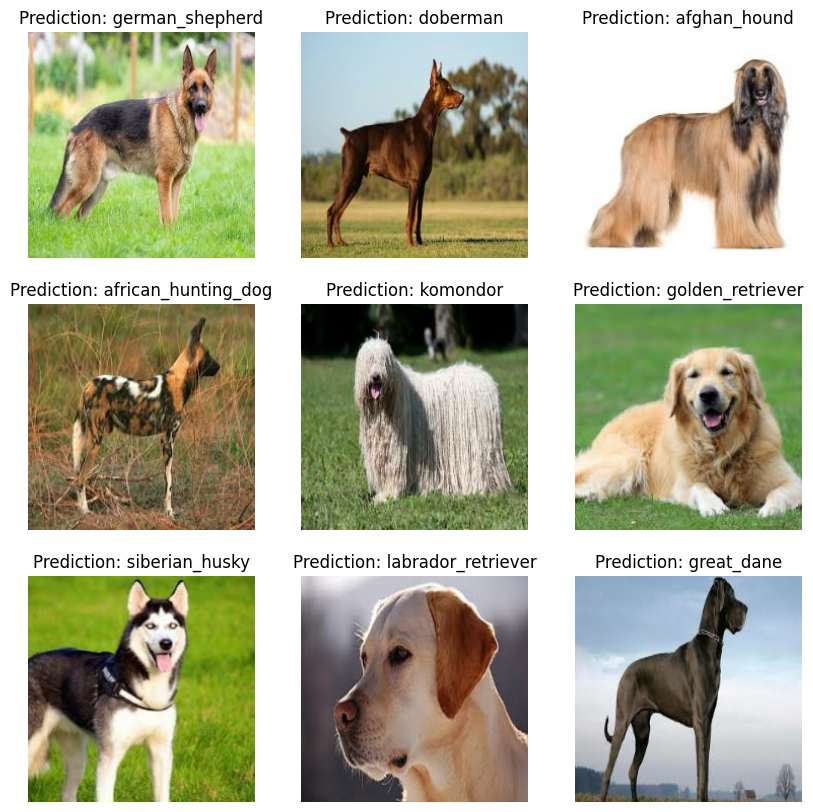

In [137]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
    plt.subplot(3, 3, i+1)
    plt.imshow(image)
    plt.title(f"Prediction: {custom_pred_labels[i]}")
    plt.axis(False);

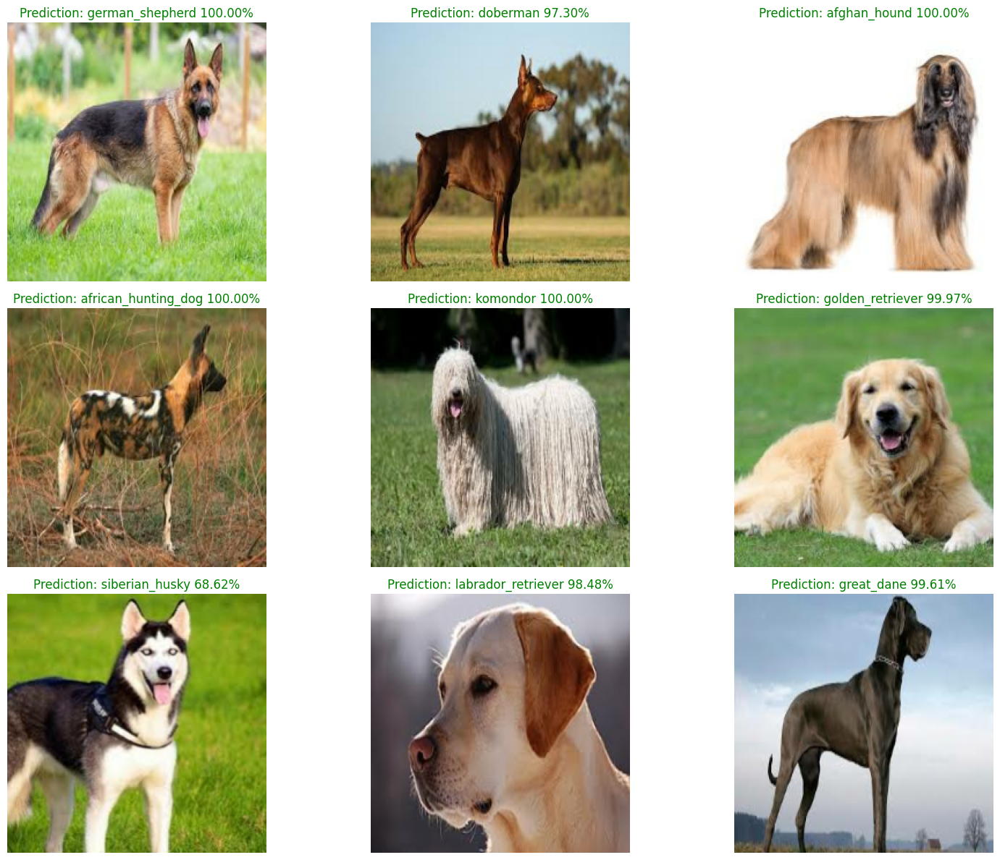

In [155]:
import matplotlib.pyplot as plt

# Visualize the predicted custom images against their prediction probabilities

plt.figure(figsize=(16, 12))
for i, image in enumerate(custom_images):
    plt.subplot(3, 3, i + 1)
    plt.imshow(image)

    # Extract prediction probabilities
    pred_prob = np.max(custom_preds[i]) * 100
    #pred_prob = custom_pred_probs[i] * 100  # Convert to percentage
    true_label_index = np.argmax(labels[i])
    true_label = unique_breeds[true_label_index]

    # Check if prediction is correct
    if pred_prob >= 60:
        title_color = "green"
    else:
        title_color = "red"

    # Set the title with prediction, true label, and prediction probability
    plt.title(
        f"Prediction: {custom_pred_labels[i]} {pred_prob:.2f}%",
        color=title_color
    )
    plt.axis(False)

# Adjust the spacing between the subplots to make room for the titles
plt.subplots_adjust(wspace=0.5, hspace=0.5)

plt.tight_layout()
plt.show();